# Import libraries

In [58]:
# library/package for data manipulation

import pandas as pd

# library/package for geodataframe manipulation

import geopandas as gpd

# library/package for mapping

import folium


# Import dataset

In [2]:
# Read-in dataset 

df = pd.read_csv('/Users/loucap/Documents/GitWork/Census_data/Data/religion_cen.csv')

In [3]:
# Take a look at column data types

df.dtypes

Lower tier local authorities Code    object
Lower tier local authorities         object
Religion (10 categories) Code         int64
Religion (10 categories)             object
Observation                           int64
dtype: object

In [4]:
# View snapshot of data using df.head()

df.head(10)

,Lower tier local authorities Code,Lower tier local authorities,Religion (10 categories) Code,Religion (10 categories),Observation
0,E06000001,Hartlepool,-8,Does not apply,0
1,E06000001,Hartlepool,1,No religion,36995
2,E06000001,Hartlepool,2,Christian,48495
3,E06000001,Hartlepool,3,Buddhist,180
4,E06000001,Hartlepool,4,Hindu,222
5,E06000001,Hartlepool,5,Jewish,27
6,E06000001,Hartlepool,6,Muslim,1213
7,E06000001,Hartlepool,7,Sikh,166
8,E06000001,Hartlepool,8,Other religion,285
9,E06000001,Hartlepool,9,Not answered,4755


# Clean dataset

In [5]:
# Clean up column names

df = df.rename(columns = {"Lower tier local authorities Code": "LA_code", "Lower tier local authorities" : "LA_name", "Religion (10 categories) Code" : "Religion_code", "Religion (10 categories)": "Religion_categories"})

In [6]:
# Let's see if it worked..

df.head()

,LA_code,LA_name,Religion_code,Religion_categories,Observation
0,E06000001,Hartlepool,-8,Does not apply,0
1,E06000001,Hartlepool,1,No religion,36995
2,E06000001,Hartlepool,2,Christian,48495
3,E06000001,Hartlepool,3,Buddhist,180
4,E06000001,Hartlepool,4,Hindu,222


In [7]:
# Subset dataframe to remove redundant category

df = df[df.Religion_categories != 'Does not apply']

In [8]:
df.head(10)

,LA_code,LA_name,Religion_code,Religion_categories,Observation
1,E06000001,Hartlepool,1,No religion,36995
2,E06000001,Hartlepool,2,Christian,48495
3,E06000001,Hartlepool,3,Buddhist,180
4,E06000001,Hartlepool,4,Hindu,222
5,E06000001,Hartlepool,5,Jewish,27
6,E06000001,Hartlepool,6,Muslim,1213
7,E06000001,Hartlepool,7,Sikh,166
8,E06000001,Hartlepool,8,Other religion,285
9,E06000001,Hartlepool,9,Not answered,4755
11,E06000002,Middlesbrough,1,No religion,52415


# Pre-processing data

In [9]:
# Calculate percentages

df['Percentage'] = df.groupby('LA_name')['Observation'].transform(lambda x: round((x / x.sum()) * 100, 2))

In [10]:
df

,LA_code,LA_name,Religion_code,Religion_categories,Observation,Percentage
1,E06000001,Hartlepool,1,No religion,36995,40.06
2,E06000001,Hartlepool,2,Christian,48495,52.52
3,E06000001,Hartlepool,3,Buddhist,180,0.19
4,E06000001,Hartlepool,4,Hindu,222,0.24
5,E06000001,Hartlepool,5,Jewish,27,0.03
...,...,...,...,...,...,...
3305,W06000024,Merthyr Tydfil,5,Jewish,5,0.01
3306,W06000024,Merthyr Tydfil,6,Muslim,289,0.49
3307,W06000024,Merthyr Tydfil,7,Sikh,82,0.14
3308,W06000024,Merthyr Tydfil,8,Other religion,229,0.39


# Data Analysis

In [11]:
# Filter dataframe to just include Christian respondents

Christianity_Frame = df[df.Religion_categories == 'Christian'].reset_index(drop = True)

In [12]:
#  Top 5 local authorities for Christians

top5_christian = Christianity_Frame.sort_values(by = 'Percentage', ascending = False).head(5).reset_index(drop = True)

In [13]:
top5_christian

,LA_code,LA_name,Religion_code,Religion_categories,Observation,Percentage
0,E08000011,Knowsley,2,Christian,102929,66.61
1,E07000124,Ribble Valley,2,Christian,40855,66.37
2,E07000029,Copeland,2,Christian,43645,65.07
3,E08000014,Sefton,2,Christian,179806,64.39
4,E08000010,Wigan,2,Christian,206870,62.82


In [14]:
# Filter dataframe to just include Muslim respondents

Muslim_Frame = df[df.Religion_categories == 'Muslim'].reset_index(drop = True)

In [15]:
Muslim_Frame

,LA_code,LA_name,Religion_code,Religion_categories,Observation,Percentage
0,E06000001,Hartlepool,6,Muslim,1213,1.31
1,E06000002,Middlesbrough,6,Muslim,14703,10.22
2,E06000003,Redcar and Cleveland,6,Muslim,984,0.72
3,E06000004,Stockton-on-Tees,6,Muslim,6675,3.40
4,E06000005,Darlington,6,Muslim,1849,1.72
...,...,...,...,...,...,...
326,W06000020,Torfaen,6,Muslim,363,0.39
327,W06000021,Monmouthshire,6,Muslim,435,0.47
328,W06000022,Newport,6,Muslim,11280,7.07
329,W06000023,Powys,6,Muslim,462,0.35


# Mapping

In [19]:
# Read-in our shapefile to a geodataframe

gdf = gpd.read_file('/Users/loucap/Documents/GitWork/Census_data/Data/Shapefiles/LAD_MAY_2022_UK_BGC_V3.shp')

In [22]:
gdf.head()

,LAD22CD,LAD22NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry
0,E06000001,Hartlepool,447160,531474,-1.27018,54.6761,2f400ad8-2901-4ac7-b323-2de4588b680e,"MULTIPOLYGON (((449812.866 525823.719, 449819...."
1,E06000002,Middlesbrough,451141,516887,-1.21099,54.5447,567ad05a-69c2-4063-b76b-1a8f661a8c03,"MULTIPOLYGON (((446860.000 517200.300, 446854...."
2,E06000003,Redcar and Cleveland,464361,519597,-1.00608,54.5675,851f8a8c-3a68-441d-a687-8c91ca574ca1,"MULTIPOLYGON (((451747.397 520561.100, 451787...."
3,E06000004,Stockton-on-Tees,444940,518183,-1.30664,54.5569,166e0146-3a5c-4cda-95f4-68893c9d063d,"MULTIPOLYGON (((446997.146 517642.744, 446963...."
4,E06000005,Darlington,428029,515648,-1.56835,54.5353,0ebbe705-9e0e-44fc-939d-e8839205db57,"POLYGON ((423475.701 524731.597, 423497.204 52..."


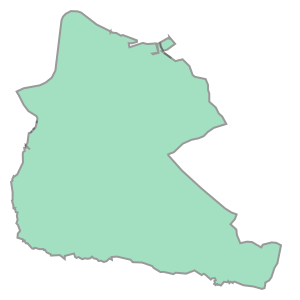

In [23]:
# Let's take a look at one of our polygons

gdf.geometry[1]

In [24]:
# Let's view the coordinates 

print(gdf.loc[0, 'geometry'])

MULTIPOLYGON (((449812.8662999999 525823.7191000003, 449819.9342 525822.5285999998, 449812.8994000005 525823.4041000009, 449812.8662999999 525823.7191000003)), ((450082.6738999998 525840.0404000003, 450082.1995999999 525839.3994999994, 450080.9422000004 525840.3790000007, 450081.5206000004 525840.2610999998, 450082.6738999998 525840.0404000003)), ((450153.6001000004 525935.8757000007, 450139.4348999998 525916.7357999999, 450139.9861000003 525921.8357999995, 450140.3121999996 525924.8535999991, 450153.6001000004 525935.8757000007)), ((450171.6244000001 525945.9683999997, 450160.5926999999 525941.6760000009, 450165.3004000001 525944.0658999998, 450171.6244000001 525945.9683999997)), ((447097.0010000002 537152.0012999997, 447228.7982999999 537033.3951999992, 447280.7010000004 537120.1004000008, 447378.0998999998 537095.0976, 447455.2983999997 537023.6980000008, 447550.4959000004 537078.1023999993, 447721.5974000003 536998.3953000009, 447851.2015000004 537036.0044999998, 447834.2001999998 

In [25]:
# View the shape of the geodataframe

gdf.shape

(374, 8)

## Clean geodataframe

In [26]:
gdf = gdf.rename(columns = {'LAD22CD': 'LA_code', 'LAD22NM' : 'LA_name'})

In [27]:
gdf.head()

,LA_code,LA_name,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry
0,E06000001,Hartlepool,447160,531474,-1.27018,54.6761,2f400ad8-2901-4ac7-b323-2de4588b680e,"MULTIPOLYGON (((449812.866 525823.719, 449819...."
1,E06000002,Middlesbrough,451141,516887,-1.21099,54.5447,567ad05a-69c2-4063-b76b-1a8f661a8c03,"MULTIPOLYGON (((446860.000 517200.300, 446854...."
2,E06000003,Redcar and Cleveland,464361,519597,-1.00608,54.5675,851f8a8c-3a68-441d-a687-8c91ca574ca1,"MULTIPOLYGON (((451747.397 520561.100, 451787...."
3,E06000004,Stockton-on-Tees,444940,518183,-1.30664,54.5569,166e0146-3a5c-4cda-95f4-68893c9d063d,"MULTIPOLYGON (((446997.146 517642.744, 446963...."
4,E06000005,Darlington,428029,515648,-1.56835,54.5353,0ebbe705-9e0e-44fc-939d-e8839205db57,"POLYGON ((423475.701 524731.597, 423497.204 52..."


In [28]:
# Replace certain values with proper names in LA_name column

gdf['LA_name'] = gdf['LA_name'].replace({'Bristol, City of': 'Bristol', 'Kingston upon Hull, City of': 'Kingston upon Hull', 'Herefordshire, County of': 'Herefordshire'})

In [32]:
# We're subsetting the data using .isin() to only keep LAs that match those in original dataset
# We reset the index after to avoid messing up the order

gdf = gdf[gdf.LA_code.isin(df.LA_code.unique())].reset_index(drop = True)

In [33]:
# Check shape is correct

gdf.shape

(331, 8)

In [37]:
# Doublecheck by getting the number of unique Local Authority codes

gdf.LA_code.nunique()

331

## Pre-processing our geodataframe

In [39]:
# Check coordinate system

gdf.crs

<Projected CRS: EPSG:27700>
Name: OSGB36 / British National Grid
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: United Kingdom (UK) - offshore to boundary of UKCS within 49°45'N to 61°N and 9°W to 2°E; onshore Great Britain (England, Wales and Scotland). Isle of Man onshore.
- bounds: (-9.01, 49.75, 2.01, 61.01)
Coordinate Operation:
- name: British National Grid
- method: Transverse Mercator
Datum: Ordnance Survey of Great Britain 1936
- Ellipsoid: Airy 1830
- Prime Meridian: Greenwich

In [40]:
# Transform the GeoDataFrame to EPSG:4326 to get latitude and longitude

gdf = gdf.to_crs("EPSG:4326")

In [41]:
print(gdf.loc[0, 'geometry'])

MULTIPOLYGON (((-1.23001435145651 54.62511517835162, -1.229905093608218 54.62510378524048, -1.230013892267561 54.62511234461969, -1.23001435145651 54.62511517835162)), ((-1.225833090709048 54.62523520728088, -1.225840545442044 54.62522949532456, -1.225859851675167 54.62523842118537, -1.225850914142844 54.62523730454138, -1.225833090709048 54.62523520728088)), ((-1.224718296859694 54.6260893240344, -1.224940944371639 54.62591874359834, -1.224931537145568 54.62596451570801, -1.224925971555091 54.62599160023734, -1.224718296859694 54.6260893240344)), ((-1.224437425999468 54.62617822667103, -1.22460901010298 54.62614075033244, -1.224535692498949 54.62616175844231, -1.224437425999468 54.62617822667103)), ((-1.270251950148207 54.72716864831848, -1.268224898772957 54.72609057611101, -1.267405068718384 54.72686482662532, -1.265896961535118 54.72663102352231, -1.264710028074531 54.72598219574238, -1.263223219608797 54.72646209602367, -1.260579849542826 54.72572972881072, -1.258561584479335 54.7

In [42]:
gdf.head()

,LA_code,LA_name,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry
0,E06000001,Hartlepool,447160,531474,-1.27018,54.6761,2f400ad8-2901-4ac7-b323-2de4588b680e,"MULTIPOLYGON (((-1.23001 54.62512, -1.22991 54..."
1,E06000002,Middlesbrough,451141,516887,-1.21099,54.5447,567ad05a-69c2-4063-b76b-1a8f661a8c03,"MULTIPOLYGON (((-1.27712 54.54791, -1.27720 54..."
2,E06000003,Redcar and Cleveland,464361,519597,-1.00608,54.5675,851f8a8c-3a68-441d-a687-8c91ca574ca1,"MULTIPOLYGON (((-1.20098 54.57763, -1.20037 54..."
3,E06000004,Stockton-on-Tees,444940,518183,-1.30664,54.5569,166e0146-3a5c-4cda-95f4-68893c9d063d,"MULTIPOLYGON (((-1.27493 54.55187, -1.27546 54..."
4,E06000005,Darlington,428029,515648,-1.56835,54.5353,0ebbe705-9e0e-44fc-939d-e8839205db57,"POLYGON ((-1.63800 54.61720, -1.63767 54.61670..."


# Merge datasets

What we want to do now is merge our 'Christianity_Frame' with 'gdf' so that we can directly access the data and map it!

In [47]:
Christianity_Frame.head()

,LA_code,LA_name,Religion_code,Religion_categories,Observation,Percentage
0,E06000001,Hartlepool,2,Christian,48495,52.52
1,E06000002,Middlesbrough,2,Christian,66143,45.96
2,E06000003,Redcar and Cleveland,2,Christian,72359,53.00
3,E06000004,Stockton-on-Tees,2,Christian,100420,51.08
4,E06000005,Darlington,2,Christian,56194,52.13


In [48]:
gdf.head()

,LA_code,LA_name,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry
0,E06000001,Hartlepool,447160,531474,-1.27018,54.6761,2f400ad8-2901-4ac7-b323-2de4588b680e,"MULTIPOLYGON (((-1.23001 54.62512, -1.22991 54..."
1,E06000002,Middlesbrough,451141,516887,-1.21099,54.5447,567ad05a-69c2-4063-b76b-1a8f661a8c03,"MULTIPOLYGON (((-1.27712 54.54791, -1.27720 54..."
2,E06000003,Redcar and Cleveland,464361,519597,-1.00608,54.5675,851f8a8c-3a68-441d-a687-8c91ca574ca1,"MULTIPOLYGON (((-1.20098 54.57763, -1.20037 54..."
3,E06000004,Stockton-on-Tees,444940,518183,-1.30664,54.5569,166e0146-3a5c-4cda-95f4-68893c9d063d,"MULTIPOLYGON (((-1.27493 54.55187, -1.27546 54..."
4,E06000005,Darlington,428029,515648,-1.56835,54.5353,0ebbe705-9e0e-44fc-939d-e8839205db57,"POLYGON ((-1.63800 54.61720, -1.63767 54.61670..."


In [53]:
merged = pd.merge(gdf, Christianity_Frame, on = ['LA_code', 'LA_name'], how = 'left')

In [54]:
merged.head()

,LA_code,LA_name,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,Religion_code,Religion_categories,Observation,Percentage
0,E06000001,Hartlepool,447160,531474,-1.27018,54.6761,2f400ad8-2901-4ac7-b323-2de4588b680e,"MULTIPOLYGON (((-1.23001 54.62512, -1.22991 54...",2,Christian,48495,52.52
1,E06000002,Middlesbrough,451141,516887,-1.21099,54.5447,567ad05a-69c2-4063-b76b-1a8f661a8c03,"MULTIPOLYGON (((-1.27712 54.54791, -1.27720 54...",2,Christian,66143,45.96
2,E06000003,Redcar and Cleveland,464361,519597,-1.00608,54.5675,851f8a8c-3a68-441d-a687-8c91ca574ca1,"MULTIPOLYGON (((-1.20098 54.57763, -1.20037 54...",2,Christian,72359,53.00
3,E06000004,Stockton-on-Tees,444940,518183,-1.30664,54.5569,166e0146-3a5c-4cda-95f4-68893c9d063d,"MULTIPOLYGON (((-1.27493 54.55187, -1.27546 54...",2,Christian,100420,51.08
4,E06000005,Darlington,428029,515648,-1.56835,54.5353,0ebbe705-9e0e-44fc-939d-e8839205db57,"POLYGON ((-1.63800 54.61720, -1.63767 54.61670...",2,Christian,56194,52.13


In [63]:
type(merged)

geopandas.geodataframe.GeoDataFrame

# Building our interactive map

This approach has been adapted from GitHub user 'vverde' who has a brilliant guide to plotting with Python and Folium. Link available here:

https://vverde.github.io/blob/interactivechoropleth.html


# Step 1: Centering the map

The first thing we need to do is provide some coordinates so we can center our map on the UK. Chat-GPT advised me that a commonly used central point for the UK is latitude 54.7, longitude -3.0.

In [55]:
lat = 54.7
lon = -3.0

# Step 2: Initialise the map

When creating a Map in Folium, you generally specify which map tile you'd like to use, and theres a ton to choose from including:

* OpenStreetMap
* CartoDB
* Mapbox 

But, we're going to break convention and set our tiles to None. According to 'vverde', if we set a tile when we initialise the map, we are then unable to hide it from the LayerControl, which is what we want to achieve later on.

In [59]:
# Initialise map by specifying location and how zoomed in you want it to be
# Tiles will be set to None

uk_map = folium.Map(location=[lat, lon], zoom_start=6, tiles = None)

In [60]:
# Yep. Trust the process, we're going to add a Tile layer in the cell below.

uk_map

In [62]:
# We're now going to add a layer of tiles over our map - in this case CartoDB positron
# We assign the name 'Light map' to our tile layer
# Control is set to False as we don't want users to be able to toggle the visibility of this layer

folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(uk_map)

uk_map

## Step 3: Draw choropleth

Now that we've set up our map with our base CartoDB positron tiles, we can now use Folium's choropleth function to plot our geometries onto the uk_map. The function below has a lot of parameters that we need to specify, including:

* geo_data = this refers to the GeoDataFrame which contains the geographic boundaries of each local authority.
* name = sets the name for this layer which we're placing on top of our base layer
* data = refers to the dataframe that contains the statistical data we'd like to plot
* columns = specifies the columns in our dataframe that Folium will use to match the geographic areas to their corresponding data values.
* key_on = tells Folium how to match the data in 'columns' with the geographic areas in geo_data. 'feature.properties.LA_code' indicates that Folium should look for a property named 'LA_code' in the GeoJSON representation of each area.

...What's a GeoJSON?

When we pass our GeoDataFrame to Folium (for example, as the geo_data parameter in the choropleth method), Folium internally converts this geographic information into GeoJSON. This conversion allows Folium to understand and render the geographic data on the map.

Okay, let's look at the last few parameters:

* fill_color = sets the colour scheme, in our case 'YIGnBu' stands for Yellow-Green-Blue, which is a nice gradient for low to high values.
* fill_opacity and line_opacity = sets opacity of the area fill and boundary lines
* legend_name = labels the legend with string value
* smooth_factor = when this value is incremented it smooths the boundaries for each geographic shape, which can improve map loading and visual clarity

In [64]:
uk_map.choropleth(
 geo_data=merged,
 name='Choropleth',
 data=merged,
 columns=['LA_code','Percentage'],
 key_on="feature.properties.LA_code",
 fill_color='YlGnBu',
 fill_opacity=1,
 line_opacity=0.2,
 legend_name='% of Christians',
 smooth_factor=0
)
uk_map

/Users/loucap/anaconda3/envs/py312/lib/python3.11/site-packages/folium/folium.py:465: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


# Step 4: Add interactive elements

The following code adds interactivity to the map with custom styling for the map's features and tooltips which display specific information about a local authrotiy when a user scrolls over it.

In [65]:
# Use the anonymous lambda functions to define how each geographic area should be styled 

# this function defines how each area should be defined normally - i.e. when not being highlighted
# fillColor - fills areas with white colour, whilst  colour sets the border colour to black
# fillOpacity - defines how transparant the colour is
# weight - sets border thickness

style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}

# this function defines how each area should appear when highlighted with mouse

highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

The code below creates a GeoJson layer for the map, which allows us to add geographic data from our 'merged' GeoDataFrame with the specified styles and interactive features. Let's go through these parameters step by step:

* merged - specifies the GeoDataFrame containing the geographic data and attributes
* style_function = applies the styling to each geographic area, so border colour etc
* control = specifies that this layer shouldn't have a toggle option
* highlight_function = applies highlighting style when user hovers over area with mouse
* tooltip = defines a tooltip with relevant data that will be shown when user hovers over area

In [66]:
features = folium.features.GeoJson(
    merged,
    style_function=style_function, 
    control=False,
    highlight_function=highlight_function, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['LA_name','Percentage', 'Observation'],
        aliases=['LA name: ','% of Christians: ', 'Count'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)

In [67]:
# Use add_child function to add interactivee layer to uk_map

uk_map.add_child(features)